In [1]:
#Basic and most important libraries
import pandas as pd , numpy as np
from sklearn.utils import resample
from sklearn.preprocessing import StandardScaler , MinMaxScaler
from collections import Counter
from scipy import stats
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import plotly




#Data processing functions

from sklearn.model_selection import train_test_split
from sklearn import model_selection
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

import warnings
warnings.filterwarnings("ignore")


In [2]:
df=pd.read_csv("covid data.csv")

In [3]:
df.head(10) # to display first 10 rows of data set

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered
0,1,01/22/2020,Anhui,Mainland China,1/22/2020 17:00,1,0,0
1,2,01/22/2020,Beijing,Mainland China,1/22/2020 17:00,14,0,0
2,3,01/22/2020,Chongqing,Mainland China,1/22/2020 17:00,6,0,0
3,4,01/22/2020,Fujian,Mainland China,1/22/2020 17:00,1,0,0
4,5,01/22/2020,Gansu,Mainland China,1/22/2020 17:00,0,0,0
5,6,01/22/2020,Guangdong,Mainland China,1/22/2020 17:00,26,0,0
6,7,01/22/2020,Guangxi,Mainland China,1/22/2020 17:00,2,0,0
7,8,01/22/2020,Guizhou,Mainland China,1/22/2020 17:00,1,0,0
8,9,01/22/2020,Hainan,Mainland China,1/22/2020 17:00,4,0,0
9,10,01/22/2020,Hebei,Mainland China,1/22/2020 17:00,1,0,0


In [4]:
df.shape

(306429, 8)

In [5]:
df.info() # to check total information of the dataset.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 306429 entries, 0 to 306428
Data columns (total 8 columns):
 #   Column           Non-Null Count   Dtype 
---  ------           --------------   ----- 
 0   SNo              306429 non-null  int64 
 1   ObservationDate  306429 non-null  object
 2   Province/State   228329 non-null  object
 3   Country/Region   306429 non-null  object
 4   Last Update      306429 non-null  object
 5   Confirmed        306429 non-null  int64 
 6   Deaths           306429 non-null  int64 
 7   Recovered        306429 non-null  int64 
dtypes: int64(4), object(4)
memory usage: 18.7+ MB


In [6]:
df.isnull().sum() # To check / find null  values  in the dataset.

SNo                    0
ObservationDate        0
Province/State     78100
Country/Region         0
Last Update            0
Confirmed              0
Deaths                 0
Recovered              0
dtype: int64

In [7]:
import datetime 

In [8]:
pd.to_datetime(df["ObservationDate"])

0        2020-01-22
1        2020-01-22
2        2020-01-22
3        2020-01-22
4        2020-01-22
            ...    
306424   2021-05-29
306425   2021-05-29
306426   2021-05-29
306427   2021-05-29
306428   2021-05-29
Name: ObservationDate, Length: 306429, dtype: datetime64[ns]

In [9]:
# changing data observation date  into hours
df["ObservationDate"]=pd.to_datetime(df["ObservationDate"])-datetime.timedelta(hours=4)

In [10]:
df["year"]=df.ObservationDate.dt.year
df["month"]=df.ObservationDate.dt.month
df["day"]=df.ObservationDate.dt.day

In [11]:
df.head(10) # to display first five rows

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,year,month,day
0,1,2020-01-21 20:00:00,Anhui,Mainland China,1/22/2020 17:00,1,0,0,2020,1,21
1,2,2020-01-21 20:00:00,Beijing,Mainland China,1/22/2020 17:00,14,0,0,2020,1,21
2,3,2020-01-21 20:00:00,Chongqing,Mainland China,1/22/2020 17:00,6,0,0,2020,1,21
3,4,2020-01-21 20:00:00,Fujian,Mainland China,1/22/2020 17:00,1,0,0,2020,1,21
4,5,2020-01-21 20:00:00,Gansu,Mainland China,1/22/2020 17:00,0,0,0,2020,1,21
5,6,2020-01-21 20:00:00,Guangdong,Mainland China,1/22/2020 17:00,26,0,0,2020,1,21
6,7,2020-01-21 20:00:00,Guangxi,Mainland China,1/22/2020 17:00,2,0,0,2020,1,21
7,8,2020-01-21 20:00:00,Guizhou,Mainland China,1/22/2020 17:00,1,0,0,2020,1,21
8,9,2020-01-21 20:00:00,Hainan,Mainland China,1/22/2020 17:00,4,0,0,2020,1,21
9,10,2020-01-21 20:00:00,Hebei,Mainland China,1/22/2020 17:00,1,0,0,2020,1,21


In [12]:
grouped_df = df[["Country/Region","Confirmed","Deaths","Recovered"]]
grouped_df

,Country/Region,Confirmed,Deaths,Recovered
0,Mainland China,1,0,0
1,Mainland China,14,0,0
2,Mainland China,6,0,0
3,Mainland China,1,0,0
4,Mainland China,0,0,0
...,...,...,...,...
306424,Ukraine,102641,2335,95289
306425,Netherlands,29147,245,0
306426,Mainland China,1364,1,1324
306427,Ukraine,87550,1738,83790


In [13]:
grouped_df = grouped_df.sort_values(by="Confirmed",ascending=False)
grouped_df = grouped_df.reset_index(drop=True)
grouped_df

,Country/Region,Confirmed,Deaths,Recovered
0,France,5863138,107390,324444
1,France,5845010,107256,323205
2,France,5829009,107041,321874
3,France,5825659,106845,321026
4,France,5811711,106764,320711
...,...,...,...,...
306424,Colombia,0,0,0
306425,India,0,0,0
306426,Mainland China,0,0,3
306427,Mexico,0,0,1755798


In [14]:
grouped=df[["Confirmed","Deaths","Recovered","Country/Region"]]
grouped.head()

,Confirmed,Deaths,Recovered,Country/Region
0,1,0,0,Mainland China
1,14,0,0,Mainland China
2,6,0,0,Mainland China
3,1,0,0,Mainland China
4,0,0,0,Mainland China


In [15]:
df.head()

,SNo,ObservationDate,Province/State,Country/Region,Last Update,Confirmed,Deaths,Recovered,year,month,day
0,1,2020-01-21 20:00:00,Anhui,Mainland China,1/22/2020 17:00,1,0,0,2020,1,21
1,2,2020-01-21 20:00:00,Beijing,Mainland China,1/22/2020 17:00,14,0,0,2020,1,21
2,3,2020-01-21 20:00:00,Chongqing,Mainland China,1/22/2020 17:00,6,0,0,2020,1,21
3,4,2020-01-21 20:00:00,Fujian,Mainland China,1/22/2020 17:00,1,0,0,2020,1,21
4,5,2020-01-21 20:00:00,Gansu,Mainland China,1/22/2020 17:00,0,0,0,2020,1,21


In [16]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
import plotly.express as px

pio.templates.default = "plotly_dark"

In [17]:
px.scatter_3d(grouped,x="Confirmed",y="Deaths",z="Recovered")

In [19]:
px.bar(grouped_df[0:500], x="Country/Region", y="Confirmed",title="Top 10 Countries with confirmed cases")

In [20]:
px.bar(grouped_df[0:500], x="Country/Region", y="Deaths",title="Top 10 Countries with confirmed cases")

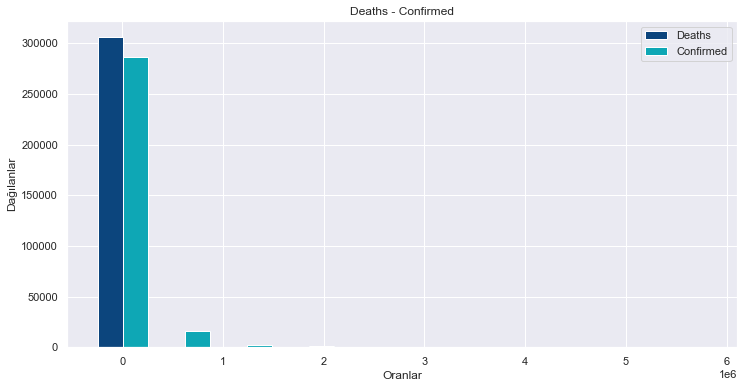

In [23]:
# HISTOGRAM    # here histogram says how many deaths confrimed  persons are there.
plt.hist([df.Deaths,df.Confirmed],
        color=["#0c457d", "#0ea7b5"],
        label=["Deaths","Confirmed"])

plt.xlabel("Oranlar")
plt.ylabel("Dağılanlar")
plt.title("Deaths - Confirmed")
plt.legend()
plt.show()

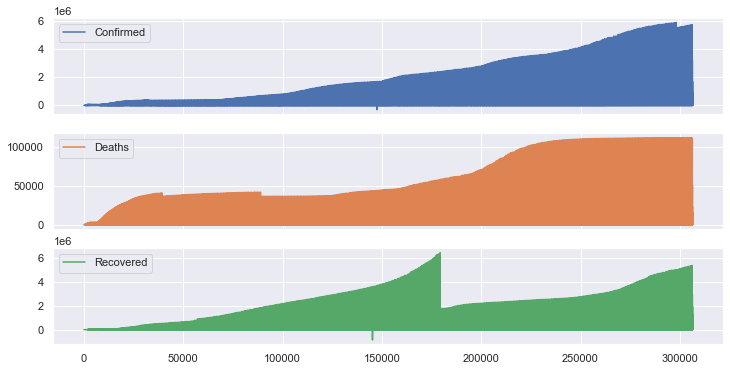

In [24]:
# we can draw subplots. #here we can see the persons who had recovered ,cofrimed  and deaths.
df = df.loc[:, ["Confirmed", "Deaths", "Recovered"]]
df.plot(subplots = True)
plt.show()

In [22]:
px.pie(grouped_df[0:600],values="Confirmed",names="Country/Region")

In [21]:
df.info() 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 306429 entries, 0 to 306428
Data columns (total 11 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   SNo              306429 non-null  int64         
 1   ObservationDate  306429 non-null  datetime64[ns]
 2   Province/State   228329 non-null  object        
 3   Country/Region   306429 non-null  object        
 4   Last Update      306429 non-null  object        
 5   Confirmed        306429 non-null  int64         
 6   Deaths           306429 non-null  int64         
 7   Recovered        306429 non-null  int64         
 8   year             306429 non-null  int64         
 9   month            306429 non-null  int64         
 10  day              306429 non-null  int64         
dtypes: datetime64[ns](1), int64(7), object(3)
memory usage: 25.7+ MB


In [26]:
from sklearn.linear_model import LinearRegression 

In [27]:
x=df.drop(['Deaths'],axis=1)
y=df[['Deaths']]

In [28]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3,random_state=1)

In [29]:
reg=LinearRegression()
reg.fit(x_train,y_train)

LinearRegression()

In [30]:
reg.score(x_train,y_train)

0.7881481781151138

In [31]:
reg.score(x_train,y_train)

0.7881481781151138

In [32]:
from sklearn.neighbors import KNeighborsRegressor
from scipy.stats import zscore

In [33]:
xscaled=x.apply(zscore) # convert all attributes
xscaled.describe()

,Confirmed,Recovered
count,3.064290e+05,3.064290e+05
mean,8.232444e-15,-2.189157e-13
std,1.000002e+00,1.000002e+00
min,-1.399796e+00,-4.490178e+00
25%,-3.049128e-01,-2.501551e-01
50%,-2.712866e-01,-2.415204e-01
75%,-1.258107e-01,-1.496202e-01
max,2.081586e+01,3.150734e+01


In [34]:
NNH =KNeighborsRegressor(n_neighbors=14)
NNH.fit(x_train,y_train)


KNeighborsRegressor(n_neighbors=14)

In [35]:
predicted_label=NNH.predict(x_test)
NNH.score(x_train,y_train)

0.8644985992031256

In [36]:
NNH.score(x_test,y_test)

0.8459139074236657

In [37]:
from sklearn.tree import DecisionTreeRegressor

In [38]:
a = DecisionTreeRegressor()

In [39]:
a.fit(x_train,y_train)

DecisionTreeRegressor()

In [40]:
a.score(x_train,y_train)

0.9983073417690926

In [41]:
a.score(x_test,y_test)

0.697199540363316

In [42]:
from sklearn.ensemble import AdaBoostRegressor

In [43]:
cs=AdaBoostRegressor()

In [44]:
cs.fit(x_train,y_train)

AdaBoostRegressor()

In [45]:
cs.score(x_train,y_train)

0.6837440639507771

In [46]:
cs.score(x_test,y_test)

0.687874995889385

In [47]:
from xgboost import XGBRegressor

In [48]:
d = XGBRegressor()

In [49]:
d.fit(x_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

In [50]:
d.score(x_train,y_train)

0.8819538589029283

In [51]:
d.score(x_test,y_test)

0.8334522057262295

In [52]:
from sklearn.ensemble import GradientBoostingRegressor

In [53]:
d = GradientBoostingRegressor()

In [54]:
d.fit(x_train,y_train)

GradientBoostingRegressor()

In [55]:
d.score(x_train,y_train)

0.8364985896694304

In [56]:
d.score(x_test,y_test)

0.8306225042125517

In [57]:
from sklearn.ensemble import  RandomForestRegressor

In [58]:
c = RandomForestRegressor()

In [59]:
c.fit(x_train,y_train)

RandomForestRegressor()

In [60]:
c.score(x_train,y_train)

0.9717043858575174

In [61]:
c.score(x_test,y_test)

0.8018587226730821

In [62]:
from sklearn.model_selection import GridSearchCV

In [63]:
param_grid = { "bootstrap":[True],
               "max_features":[2,3],
               "max_depth":[5,6],
               "min_samples_leaf":[3,4],
               "min_samples_split":[5,10],
               "n_estimators":[5,6,7]
    
}

In [64]:
rf = RandomForestRegressor(random_state = 1)

In [65]:
grid_search = GridSearchCV(estimator = rf,param_grid = param_grid,
                          cv=3,return_train_score=True)

In [66]:
# fit the grid search to the data
grid_search.fit(x_train,y_train);

In [67]:
grid_search.best_params_

{'bootstrap': True,
 'max_depth': 6,
 'max_features': 2,
 'min_samples_leaf': 4,
 'min_samples_split': 10,
 'n_estimators': 7}

In [68]:
best_grid = grid_search.best_estimator_
best_grid.score(x_test,y_test)

0.8317657087108867

In [69]:
best_grid.score(x_train,y_train)

0.8365159746941577

In [70]:
rf.fit(x_train,y_train)

RandomForestRegressor(random_state=1)

In [71]:
rf.score(x_train,y_train)

0.971562610445289

In [72]:
rf.score(x_test,y_test)

0.8015989283517655

In [73]:
# Transformation

In [74]:
# data standardization with  sklearn
from sklearn.preprocessing import StandardScaler

# copy of datasets
x_train_stand = x_train.copy()
x_test_stand = x_test.copy()

# numerical features
num_cols = ['Confirmed','Recovered']

# apply standardization on numerical features
for i in num_cols:
    
    # fit on training data column
    scale = StandardScaler().fit(x_train_stand[[i]])
    
    # transform the training data column
    x_train_stand[i] = scale.transform(x_train_stand[[i]])
    
    # transform the testing data column
    x_test_stand[i] = scale.transform(x_test_stand[[i]])

In [75]:
rf.fit(x_train_stand,y_train)

RandomForestRegressor(random_state=1)

In [76]:
rf.score(x_train_stand,y_train)

0.9715540668554514

In [77]:
rf.score(x_test_stand,y_test)

0.8015826915989424

In [78]:
from sklearn.ensemble import GradientBoostingRegressor

In [79]:
d.fit(x_train_stand,y_train)

GradientBoostingRegressor()

In [80]:
d.score(x_train_stand,y_train)

0.8364985896694304

In [81]:
d.score(x_test_stand,y_test)

0.8307013489403032

In [82]:
from sklearn.linear_model import LinearRegression 

In [83]:
reg.fit(x_train_stand,y_train)

LinearRegression()

In [84]:
reg.score(x_train_stand,y_train)

0.7881481781151138

In [85]:
reg.score(x_test_stand,y_test)

0.7949435845700338

In [86]:
from sklearn.tree import DecisionTreeRegressor

In [87]:
a.fit(x_train_stand,y_train)

DecisionTreeRegressor()

In [88]:
a.score(x_train_stand,y_train)

0.9983073417690926

In [89]:
a.score(x_test_stand,y_test)

0.7017468949224075

In [90]:
from xgboost import XGBRegressor

In [91]:
d=XGBRegressor()

In [92]:
d.fit(x_train_stand,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.300000012, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=100, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, ...)

In [93]:
d.score(x_train_stand,y_train)

0.8819538589029283

In [94]:
d.score(x_test_stand,y_test)

0.8334514186787678

In [95]:
# data normalization with sklearn
from sklearn.preprocessing import MinMaxScaler

# fit scaler on training data
norm = MinMaxScaler().fit(x_train)

# transform training data
x_train_norm = norm.transform(x_train)

# transform testing dataabs
x_test_norm = norm.transform(x_test)

In [96]:
from sklearn.linear_model import LinearRegression 

In [97]:
reg.fit(x_train_norm,y_train)

LinearRegression()

In [98]:
reg.score(x_train_norm,y_train)

0.7881481781151138

In [99]:
reg.score(x_test_norm,y_test)

0.7949435845700338

In [100]:
rf.fit(x_train_norm,y_train)

RandomForestRegressor(random_state=1)

In [101]:
rf.score(x_train_norm,y_train)

0.971558570600453

In [102]:
rf.score(x_test_norm,y_test)

0.8015802060167085

In [103]:
from sklearn.tree import DecisionTreeRegressor

In [104]:
a.fit(x_train_norm,y_train)

DecisionTreeRegressor()

In [105]:
a.score(x_train_norm,y_train)

0.9983073417690926

In [106]:
a.score(x_test_norm,y_test)

0.7020540041528949

In [107]:
from sklearn.ensemble import GradientBoostingRegressor

In [108]:
d = GradientBoostingRegressor()

In [109]:
d.fit(x_train_norm,y_train)

GradientBoostingRegressor()

In [110]:
d.score(x_train_norm,y_train)

0.8364985896694304

In [111]:
d.score(x_test_norm,y_test)

0.8306346420276965